In [15]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import shutil
import matplotlib.pyplot as plt
import numpy as np
import librosa
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import random

In [16]:
output_dir = "cift"

# Clear the contents of the output directory
shutil.rmtree(output_dir, ignore_errors=True)
os.makedirs(output_dir, exist_ok=True)

print(f"Contents of {output_dir} cleared.")

Contents of cift cleared.


In [18]:
import librosa
import soundfile as sf

# Path to the dataset
# Mevcut çalışma dizinini alır
current_directory = os.getcwd()

print("Mevcut çalışma dizini:", current_directory)

current_directory = os.path.join(current_directory,"parcali")
print("Mevcut çalışma dizini:", current_directory)

# Output directory to save the combined files
output_dir = "cift"

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# List of speaker folders
speaker_folders = [
    "mehmetkocoglu",
    "tahakocer",
    "Benjamin_Netanyau",
    "Jens_Stoltenberg",
    "Julia_Gillard",
    "Magaret_Tarcher",
    "Nelson_Mandela"
    
]

# Number of files to combine for each speaker
num_files_to_combine = 120

# Iterate over each speaker's folder
for speaker_folder in speaker_folders:
    speaker_folder_path = os.path.join(current_directory, speaker_folder)

    # List the first num_files_to_combine WAV files in the speaker's folder
    wav_files = [f"chunk_{i}.wav" for i in range(num_files_to_combine)]

    # Combine all WAV files into a single long file
    combined_audio = []
    for wav_file in wav_files:
        wav_file_path = os.path.join(speaker_folder_path, wav_file)
        audio, sr = librosa.load(wav_file_path, sr=None)
        combined_audio.extend(audio)

    # Save the combined audio file
    output_file_path = os.path.join(output_dir, f"{speaker_folder}_combined.wav")
    sf.write(output_file_path, combined_audio, sr)

print("Combination complete. Combined files saved in:", output_dir)

Mevcut çalışma dizini: C:\Users\memoc\deeplearning-workspace\speaker-recognition-DL
Mevcut çalışma dizini: C:\Users\memoc\deeplearning-workspace\speaker-recognition-DL\parcali
Combination complete. Combined files saved in: cift


In [19]:
from IPython.display import display, Audio

# Function to play audio file
def play_audio(audio_path):
    display(Audio(filename=audio_path))

# Play a specific combined audio file
speaker_folder = "mehmetkocoglu_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)

Click the play button to listen: cift\mehmetkocoglu_combined.wav


In [20]:
# Function to play audio file
def play_audio(audio_path):
    display(Audio(filename=audio_path))

# Play a specific combined audio file
speaker_folder = "tahakocer_combined"
audio_path = os.path.join(output_dir, f"{speaker_folder}.wav")
print(f"Click the play button to listen: {audio_path}")
play_audio(audio_path)

Click the play button to listen: cift\tahakocer_combined.wav


C:\Users\memoc\AppData\Local\Temp\ipykernel_11680\1786270940.py:19: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


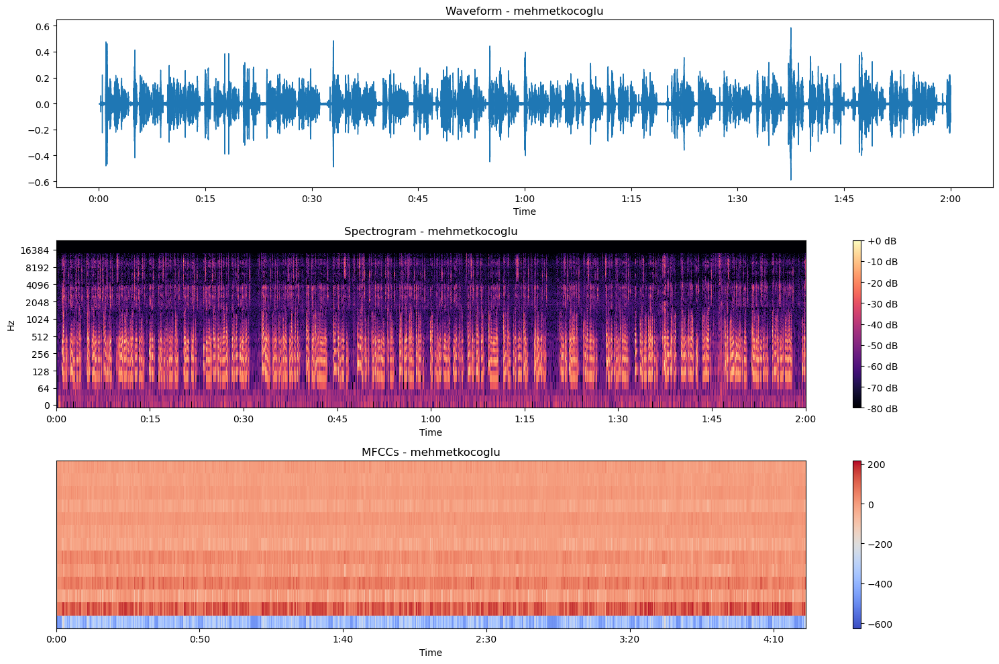

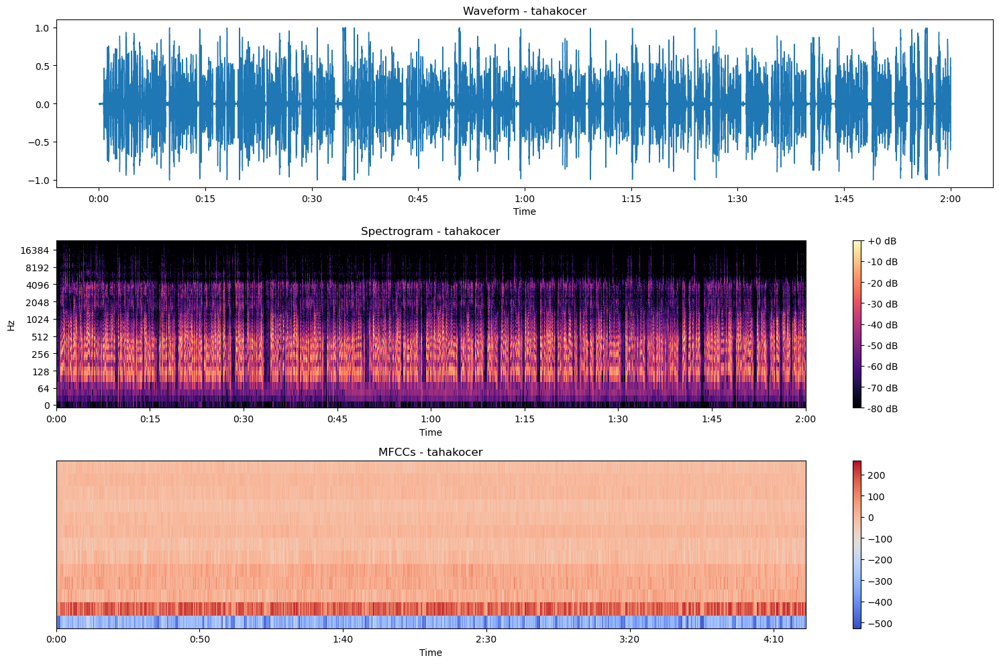

In [21]:
import librosa.display

# Function to plot the waveform, spectrogram, and MFCCs
def plot_audio_features(audio_path):
    # Load audio file
    y, sr = librosa.load(audio_path, sr=None)

    # Extract speaker name from the file path
    speaker_name = os.path.basename(audio_path).split('_')[0]

    # Plot the waveform
    plt.figure(figsize=(15, 10))
    plt.subplot(3, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f'Waveform - {speaker_name}')

    # Plot the spectrogram
    plt.subplot(3, 1, 2)
    D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Spectrogram - {speaker_name}')

    # Plot the MFCCs
    plt.subplot(3, 1, 3)
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    librosa.display.specshow(mfccs, x_axis='time')
    plt.colorbar()
    plt.title(f'MFCCs - {speaker_name}')

    plt.tight_layout()
    plt.show()

# Paths to the combined audio files
audio_paths = [
    r'cift\mehmetkocoglu_combined.wav',
    r'cift\tahakocer_combined.wav'
]

# Plot features for each audio file
for audio_path in audio_paths:
    plot_audio_features(audio_path)

In [22]:
import os
import numpy as np
import librosa
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import random

# Set the parent directory for speaker folders
current_directory = os.getcwd()
print("Mevcut çalışma dizini:", current_directory)
current_directory = os.path.join(current_directory, "parcali")
print("Mevcut çalışma dizini:", current_directory)

# List of speaker folders
speaker_folders = [
    "mehmetkocoglu",
    "tahakocer",
    "Benjamin_Netanyau",
    "Jens_Stoltenberg",
    "Julia_Gillard",
    "Magaret_Tarcher",
    "Nelson_Mandela"
]

def augment_audio(audio, sr):
    # Random time shift
    time_shift = np.random.randint(sr)
    audio = np.roll(audio, time_shift)
    
    # Random noise injection
    noise = np.random.randn(len(audio))
    audio = audio + 0.005 * noise
    
    return audio

def extract_features(current_directory, speaker_folders, max_length=44):
    features = []
    labels = []

    for i, speaker_folder in enumerate(speaker_folders):
        speaker_folder_path = os.path.join(current_directory, speaker_folder)

        for filename in os.listdir(speaker_folder_path):
            if filename.endswith(".wav"):
                file_path = os.path.join(speaker_folder_path, filename)
                audio, sr = librosa.load(file_path, sr=None, duration=1)
                
                # Augment audio data
                audio = augment_audio(audio, sr)
                
                mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13)
                
                # Normalize MFCC features
                mfccs = StandardScaler().fit_transform(mfccs)
                
                # Pad or truncate MFCCs to ensure consistent shape
                if mfccs.shape[1] < max_length:
                    mfccs = np.pad(mfccs, ((0, 0), (0, max_length - mfccs.shape[1])), mode='constant')
                else:
                    mfccs = mfccs[:, :max_length]
                
                features.append(mfccs.T)
                labels.append(i)

    return np.array(features), np.array(labels)

# Extract features and labels
X, y = extract_features(current_directory, speaker_folders)

print("Features shape:", X.shape)
print("Labels shape:", y.shape)


Mevcut çalışma dizini: C:\Users\memoc\deeplearning-workspace\speaker-recognition-DL
Mevcut çalışma dizini: C:\Users\memoc\deeplearning-workspace\speaker-recognition-DL\parcali
Features shape: (10502, 44, 13)
Labels shape: (10502,)


In [23]:
for feature in X[:1]:
    print(feature)

[[-3.45234783e+00  3.00241963e-01  3.27388073e-01  3.58163952e-01
   3.72962853e-01  3.97725348e-01  3.93829273e-01  1.90165003e-01
   1.31531297e-01  1.60983457e-01  2.82154067e-01  2.66001846e-01
   2.71200700e-01]
 [-3.46214981e+00  3.07661025e-01  3.06397392e-01  3.15274203e-01
   3.36583862e-01  3.34890547e-01  3.17177771e-01  2.47367708e-01
   2.37842734e-01  2.36920037e-01  2.70084939e-01  2.62136591e-01
   2.89812999e-01]
 [-3.46363235e+00  2.86473889e-01  2.83530463e-01  3.17081753e-01
   3.12504940e-01  2.76894665e-01  3.09323872e-01  2.84774030e-01
   2.79354755e-01  2.71841207e-01  2.96561884e-01  2.89806652e-01
   2.55484244e-01]
 [-3.46009036e+00  2.53725905e-01  2.47246782e-01  3.32054123e-01
   3.66261970e-01  3.46380146e-01  3.51624381e-01  2.79772566e-01
   2.61958181e-01  2.66481474e-01  2.92394523e-01  2.75975890e-01
   1.86214418e-01]
 [-3.46052625e+00  3.34205402e-01  3.34755986e-01  3.28704739e-01
   2.78093513e-01  2.94434541e-01  2.75871764e-01  2.08996481e-01


In [24]:

# Encode labels with explicit classes
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)
label_encoder.classes_ = np.array(speaker_folders)

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=30)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=30)

# Print the shapes of training and validation data
print("Training Data Shape:", X_train.shape)
print("Validation Data Shape:", X_val.shape)

Training Data Shape: (7351, 44, 13)
Validation Data Shape: (1575, 44, 13)


In [25]:
# Define the RNN model
model = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.LSTM(128),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(len(speaker_folders), activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Learning rate scheduler
# Learning rate scheduler
def scheduler(epoch, lr):
    if epoch < 10:
        return lr
    else:
        return float(lr * tf.math.exp(-0.1))
lr_scheduler = LearningRateScheduler(scheduler)

# Train the model with EarlyStopping and LearningRateScheduler
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, batch_size=32)

# Check if EarlyStopping triggered
if early_stopping.stopped_epoch > 0:
    print("Early stopping triggered at epoch", early_stopping.stopped_epoch + 1)
else:
    print("Training completed without early stopping")

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f'Test loss: {test_loss}, Test accuracy: {test_accuracy}')

Epoch 1/20


C:\Users\memoc\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


230/230 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - accuracy: 0.6945 - loss: 0.7548 - val_accuracy: 0.9263 - val_loss: 0.2496
Epoch 2/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 30ms/step - accuracy: 0.9065 - loss: 0.2681 - val_accuracy: 0.9162 - val_loss: 0.2008
Epoch 3/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - accuracy: 0.9231 - loss: 0.2257 - val_accuracy: 0.9467 - val_loss: 0.1426
Epoch 4/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - accuracy: 0.9383 - loss: 0.1913 - val_accuracy: 0.9594 - val_loss: 0.1258
Epoch 5/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - accuracy: 0.9498 - loss: 0.1575 - val_accuracy: 0.9625 - val_loss: 0.0939
Epoch 6/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - accuracy: 0.9516 - loss: 0.1342 - val_accuracy: 0.9562 - val_loss: 0.1063
Epoch 7/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - accuracy: 0.9567 - loss: 0.1323 - val_accuracy: 0.9467 - val_loss: 0.1593
Epoch 8/20
230/230 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - accuracy: 0.9584 - loss: 0.1208 - val_accuracy: 0.94

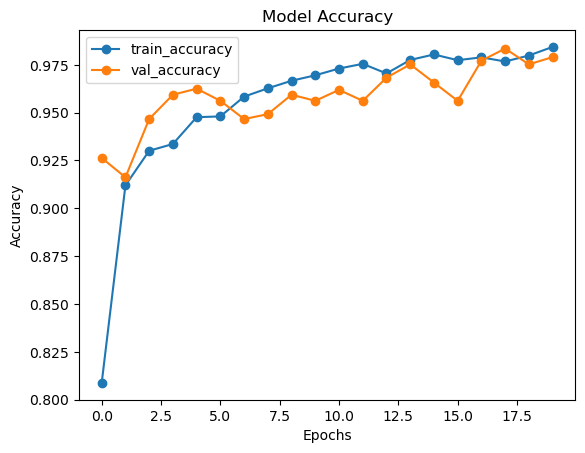

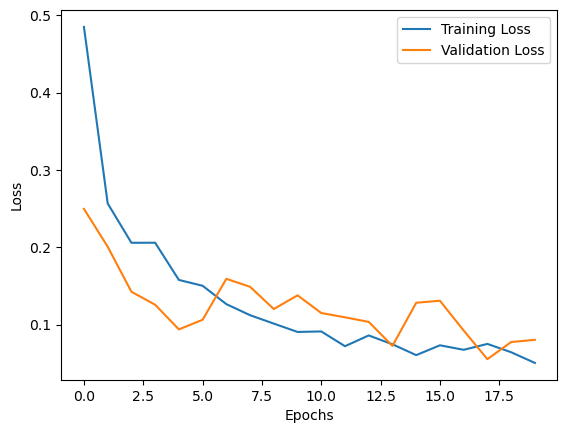

In [26]:
# Plotting model performance
plt.plot(history.history['accuracy'], label='train_accuracy', marker='o')
plt.plot(history.history['val_accuracy'], label='val_accuracy', marker='o')
plt.title('Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plotting model performance
# Plot training vs validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step
Test Evaluation Accuracy: 0.9714467005076142
Weighted F1 Score: 0.971300600431555


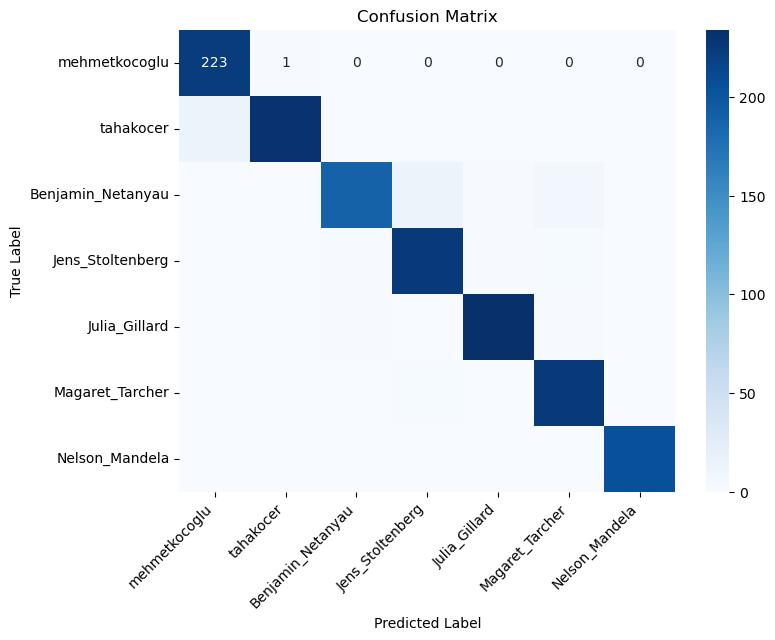

In [27]:

import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score

# Evaluate the model on the test set
y_pred_probabilities = model.predict(X_test)
y_pred = np.argmax(y_pred_probabilities, axis=1)

# Decode labels back to original format
y_test_decoded = label_encoder.inverse_transform(y_test)
y_pred_decoded = label_encoder.inverse_transform(y_pred)

# Create a confusion matrix
conf_matrix = confusion_matrix(y_test_decoded, y_pred_decoded, labels=speaker_folders)

# Calculate accuracy
accuracy = accuracy_score(y_test_decoded, y_pred_decoded)
print(f"Test Evaluation Accuracy: {accuracy}")

# Calculate F1 score
f1 = f1_score(y_test_decoded, y_pred_decoded, labels=speaker_folders, average='weighted')
print(f"Weighted F1 Score: {f1}")

# Plot the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=speaker_folders, yticklabels=speaker_folders)

# Rotate x-axis labels by 45 degrees
plt.xticks(rotation=45, ha="right")

plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [29]:
model.save('model21.keras')